In [4]:
# Import necessary libraries
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.models import Model
from tensorflow.keras.layers import GlobalAveragePooling2D, Dense, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import ReduceLROnPlateau
import os
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from mtcnn import MTCNN


In [3]:
#!pip install opencv-python
!pip install mtcnn

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 21.7 MB/s eta 0:00:00


In [5]:
def build_pretrained_model(input_shape, num_classes):
    base_model = MobileNetV2(include_top=False, weights='imagenet', input_shape=input_shape)
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(256, activation='relu')(x)
    x = Dropout(0.7)(x)
    predictions = Dense(num_classes, activation='softmax')(x)
    for layer in base_model.layers:
        layer.trainable = False
    model = Model(inputs=base_model.input, outputs=predictions)
    model.compile(optimizer=Adam(learning_rate=0.001), loss='categorical_crossentropy', metrics=['accuracy'])
    return model


In [7]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [11]:
def create_dataframe(base_dir, haar_cascade_path):
    face_cascade = cv2.CascadeClassifier(haar_cascade_path)
    data = []
    classes = []
    # Walk through the base directory and read all images and labels
    for root, dirs, files in os.walk(base_dir):
        for name in files:
            if name.endswith((".png", ".jpg", ".jpeg")):
                path = os.path.join(root, name)
                img = cv2.imread(path)
                gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
                faces = face_cascade.detectMultiScale(gray, 1.3, 5)
                for (x, y, w, h) in faces:
                    roi_color = img[y:y+h, x:x+w]
                    cropped_path = path.replace('.jpg', '_cropped.jpg')
                    cv2.imwrite(cropped_path, roi_color)
                    label = root.split(os.path.sep)[-1]
                    data.append((cropped_path, label))
                    if label not in classes:
                        classes.append(label)

    # Create a DataFrame
    df = pd.DataFrame(data, columns=['filename', 'class'])
    df = df.sample(frac=1).reset_index(drop=True)  # Shuffle the dataframe thoroughly
    return df, classes


In [13]:
def setup_data_generators(df, target_size=(224, 224), batch_size=32, validation_split=0.1):
    datagen = ImageDataGenerator(
        rescale=1./255,
        rotation_range=50,
        width_shift_range=0.1,
        height_shift_range=0.1,
        shear_range=0.1,
        zoom_range=0.1,
        horizontal_flip=True,
        fill_mode='nearest',
        validation_split=validation_split
    )

    train_df, val_df = train_test_split(df, test_size=validation_split, stratify=df['class'])

    train_generator = datagen.flow_from_dataframe(
        dataframe=train_df,
        x_col='filename',
        y_col='class',
        target_size=target_size,
        batch_size=batch_size,
        class_mode='categorical',
        shuffle=True
    )

    validation_generator = datagen.flow_from_dataframe(
        dataframe=val_df,
        x_col='filename',
        y_col='class',
        target_size=target_size,
        batch_size=batch_size,
        class_mode='categorical',
        shuffle=True
    )

    return train_generator, validation_generator


In [15]:
# Usage
base_dir = '/content/drive/MyDrive/dataset_facial/pubfig83'
haar_cascade_path = cv2.data.haarcascades + 'haarcascade_frontalface_default.xml'
df, classes = create_dataframe(base_dir, haar_cascade_path)
train_gen, val_gen = setup_data_generators(df)

model = build_pretrained_model(input_shape=(224, 224, 3), num_classes=len(classes))
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=0.0001, verbose=1)
history = model.fit(
    train_gen,
    validation_data=val_gen,
    epochs=10,
    callbacks=[reduce_lr],
    verbose=2
)


Found 284 validated image filenames belonging to 2 classes.
Found 32 validated image filenames belonging to 2 classes.
9406464/9406464 [==============================] - 1s 0us/step
Epoch 1/10
9/9 - 23s - loss: 0.7528 - accuracy: 0.6620 - val_loss: 0.4810 - val_accuracy: 0.7188 - lr: 0.0010 - 23s/epoch - 3s/step
Epoch 2/10
9/9 - 18s - loss: 0.4959 - accuracy: 0.8063 - val_loss: 0.2806 - val_accuracy: 0.8125 - lr: 0.0010 - 18s/epoch - 2s/step
Epoch 3/10
9/9 - 17s - loss: 0.3709 - accuracy: 0.8239 - val_loss: 0.5263 - val_accuracy: 0.8438 - lr: 0.0010 - 17s/epoch - 2s/step
Epoch 4/10
9/9 - 17s - loss: 0.4005 - accuracy: 0.8063 - val_loss: 0.2439 - val_accuracy: 0.9062 - lr: 0.0010 - 17s/epoch - 2s/step
Epoch 5/10
9/9 - 17s - loss: 0.2510 - accuracy: 0.9085 - val_loss: 0.2932 - val_accuracy: 0.8750 - lr: 0.0010 - 17s/epoch - 2s/step
Epoch 6/10
9/9 - 17s - loss: 0.2754 - accuracy: 0.8908 - val_loss: 0.2410 - val_accuracy: 0.8750 - lr: 0.0010 - 17s/epoch - 2s/step
Epoch 7/10
9/9 - 18s - los

1/1 [==============================] - 0s 49ms/step


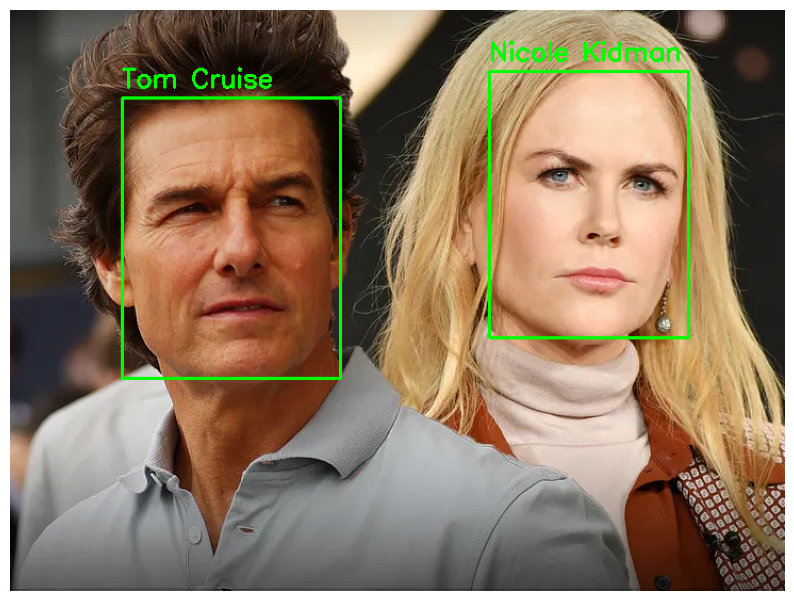

In [16]:
def identify_celebrities(model, image_path, class_indices):
    face_detector = MTCNN()
    img = cv2.imread(image_path)
    faces = face_detector.detect_faces(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    if len(faces) == 0:
        print("No faces found in the image.")
        return
    index_to_class = {v: k for k, v in class_indices.items()}
    for face in faces:
        x, y, w, h = face['box']
        face_img = img[y:y+h, x:x+w]
        face_img = cv2.resize(face_img, (224, 224))
        face_img = face_img.astype('float32') / 255.0
        face_img = np.expand_dims(face_img, axis=0)
        predictions = model.predict(face_img)
        predicted_class_index = np.argmax(predictions)
        predicted_class_name = index_to_class[predicted_class_index]
        cv2.rectangle(img, (x, y), (x+w, y+h), (0, 255, 0), 2)
        cv2.putText(img, predicted_class_name, (x, y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 255, 0), 2)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(10, 10))
    plt.imshow(img)
    plt.axis('off')
    plt.show()

# Dynamically get class indices
class_indices = train_gen.class_indices
test_image_path = 'test.jpg'
identify_celebrities(model, test_image_path, class_indices)


1/1 [==============================] - 0s 217ms/step


1/1 [==============================] - 0s 77ms/step


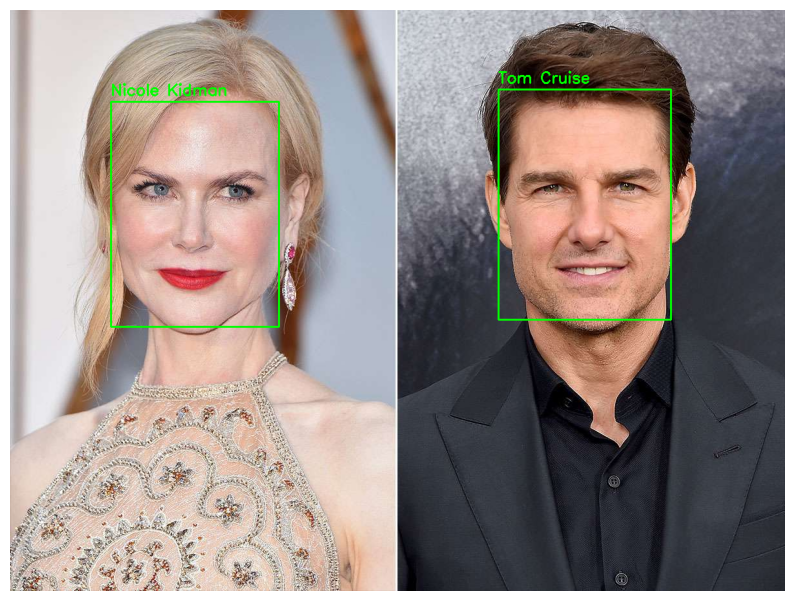

1/1 [==============================] - 0s 110ms/step


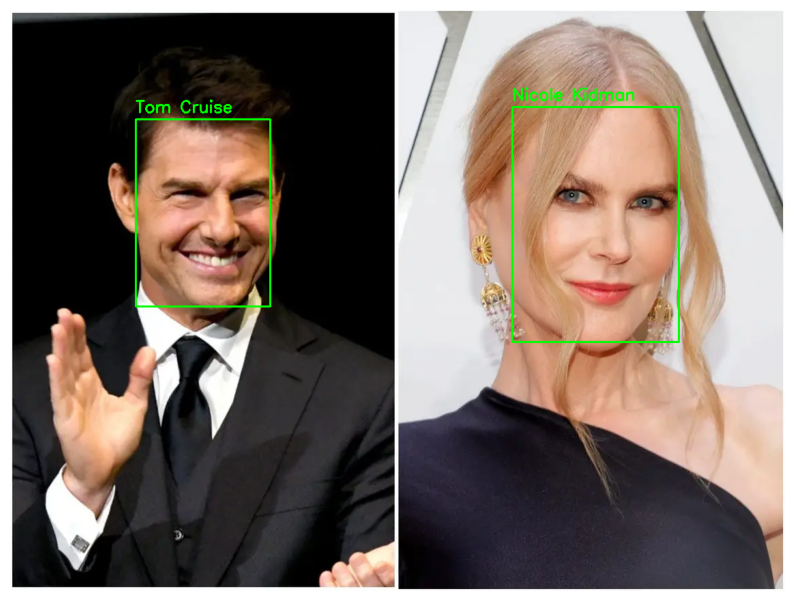

1/1 [==============================] - 0s 67ms/step


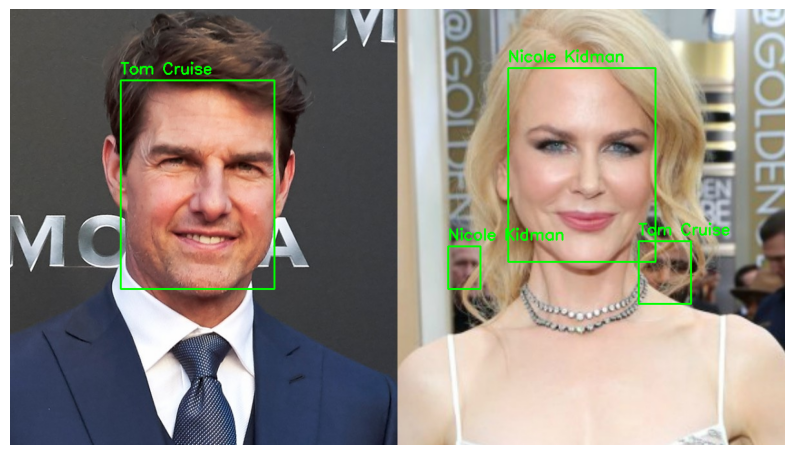

1/1 [==============================] - 0s 100ms/step


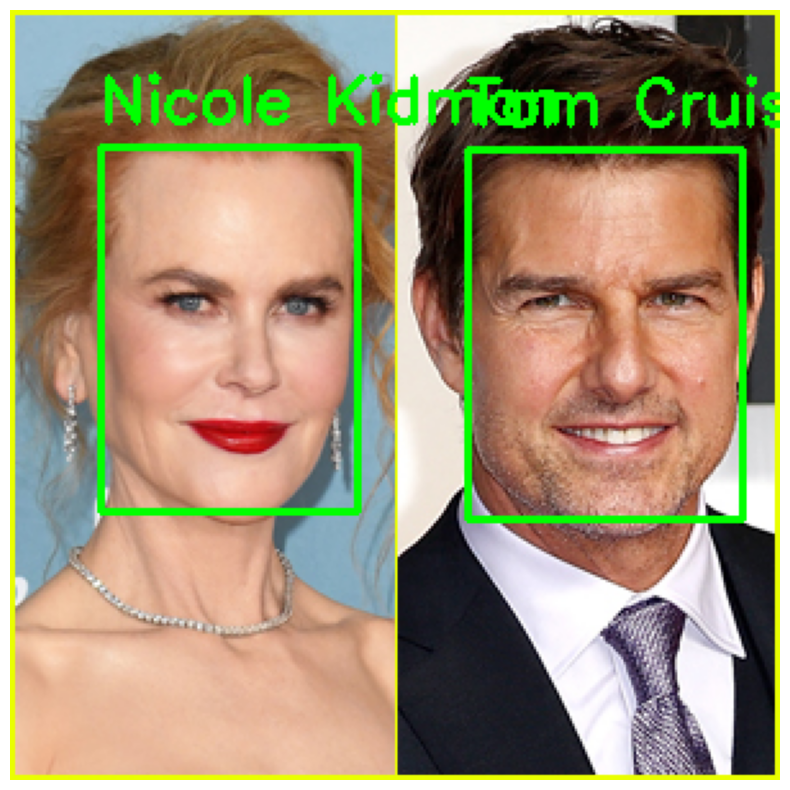

1/1 [==============================] - 0s 48ms/step


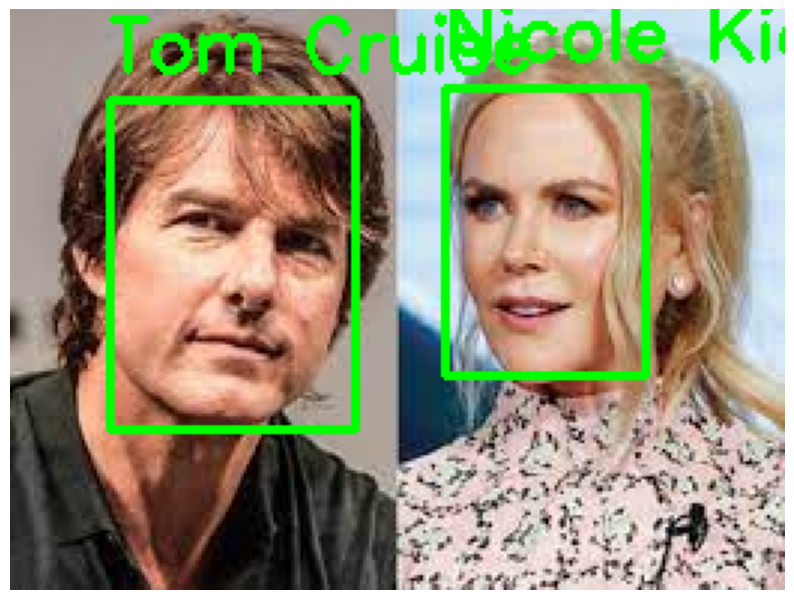

1/1 [==============================] - 0s 56ms/step


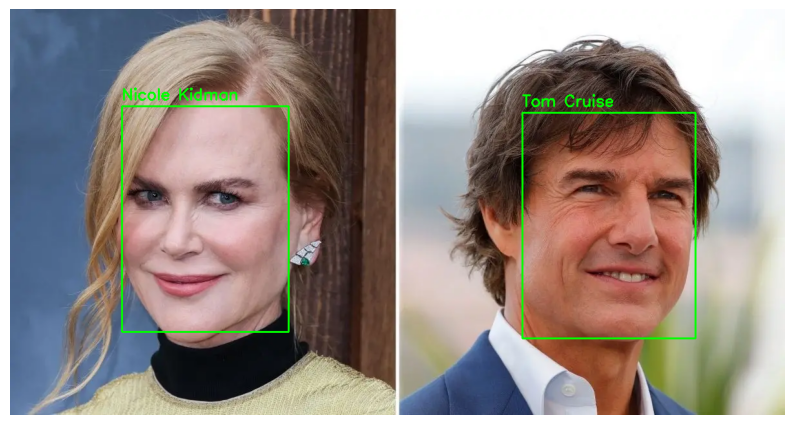

1/1 [==============================] - 0s 103ms/step


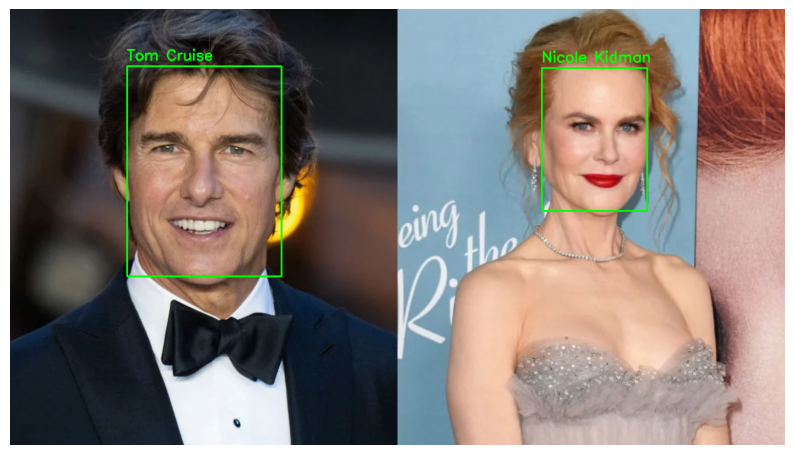

1/1 [==============================] - 0s 68ms/step


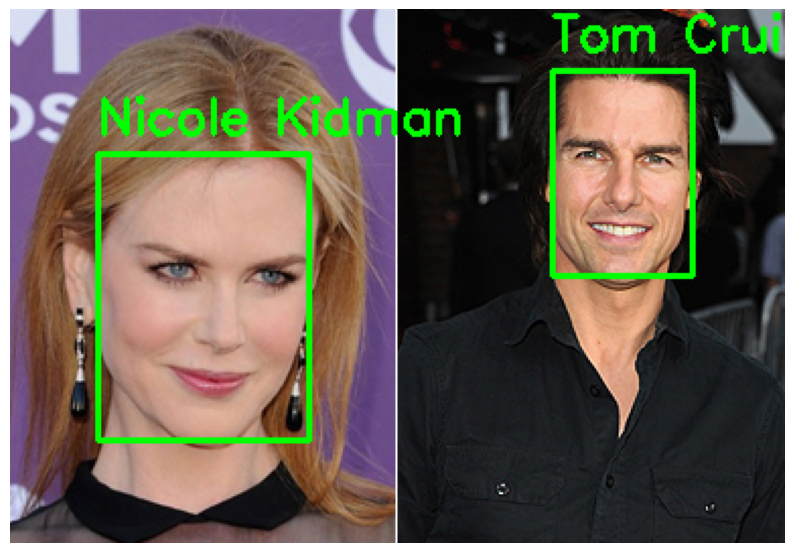

1/1 [==============================] - 0s 79ms/step


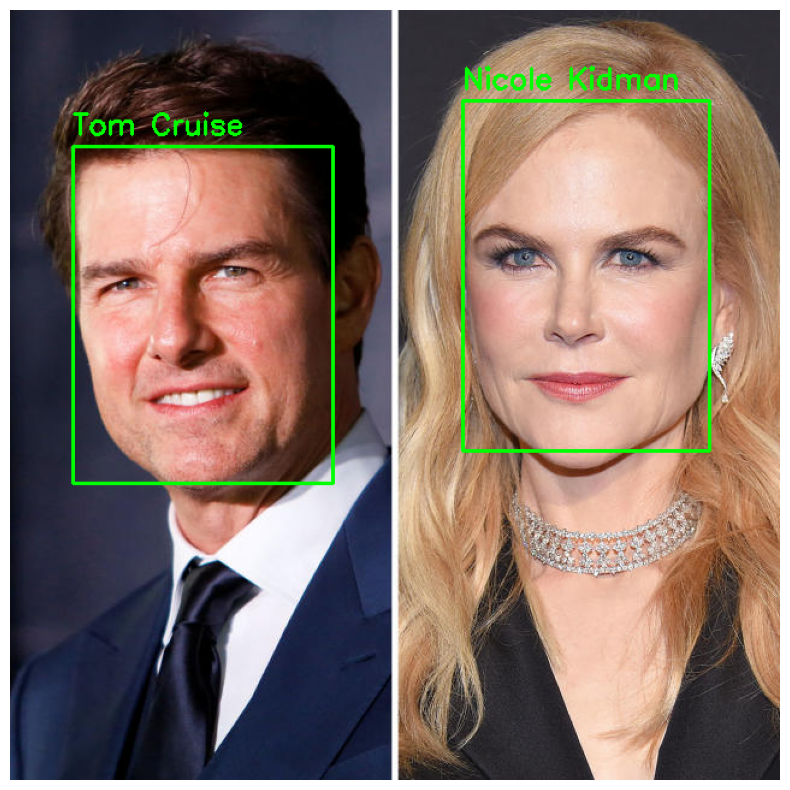

1/1 [==============================] - 0s 86ms/step


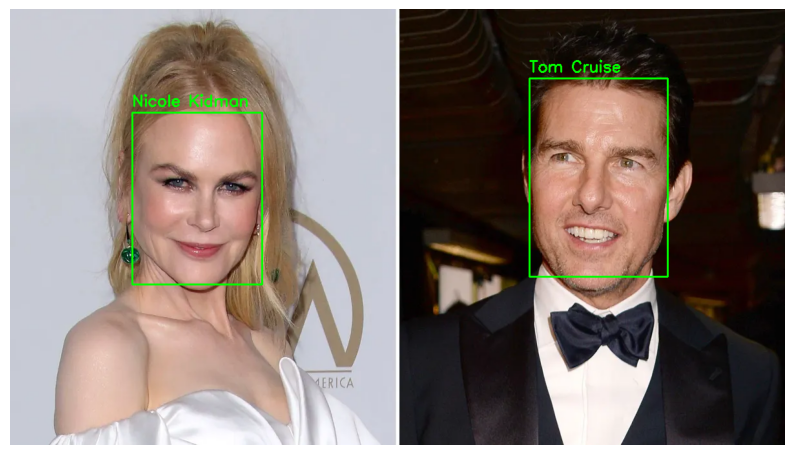

1/1 [==============================] - 0s 120ms/step


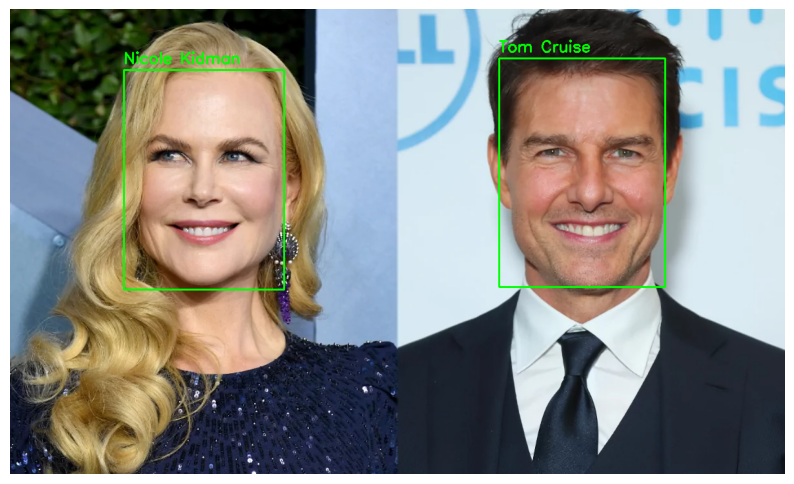

1/1 [==============================] - 0s 84ms/step


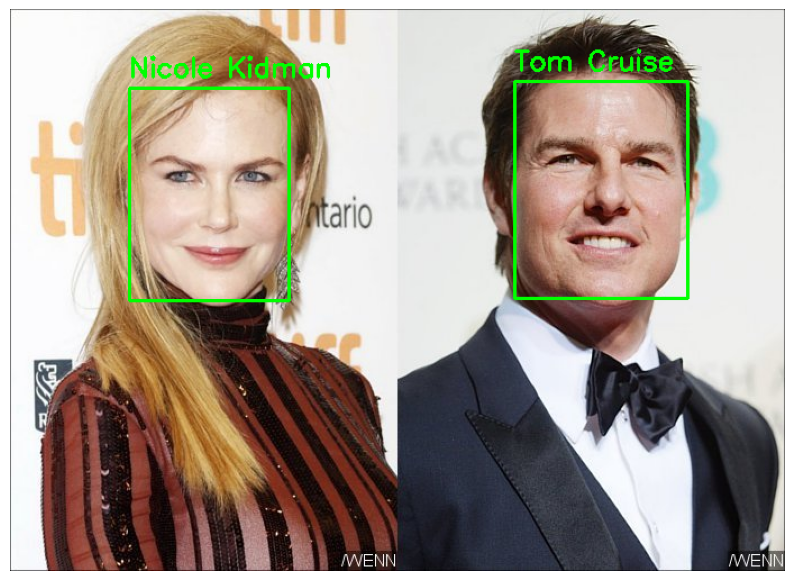

1/1 [==============================] - 0s 70ms/step


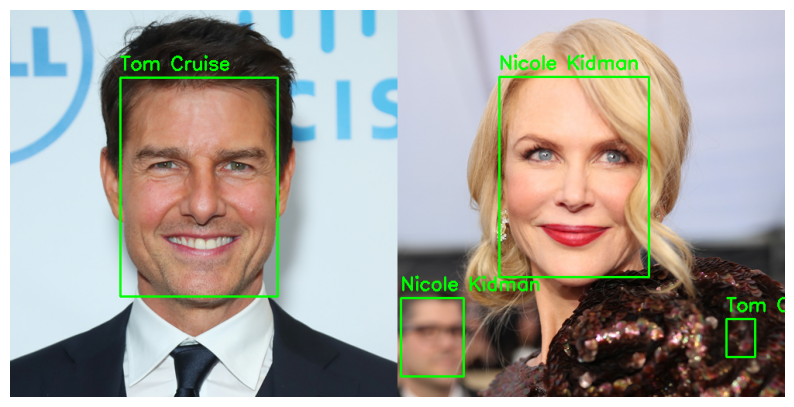

1/1 [==============================] - 0s 124ms/step


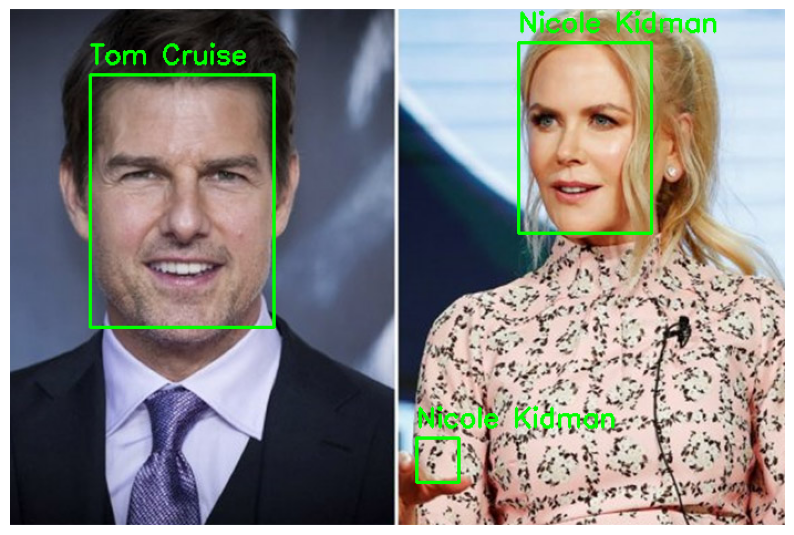

1/1 [==============================] - 0s 91ms/step


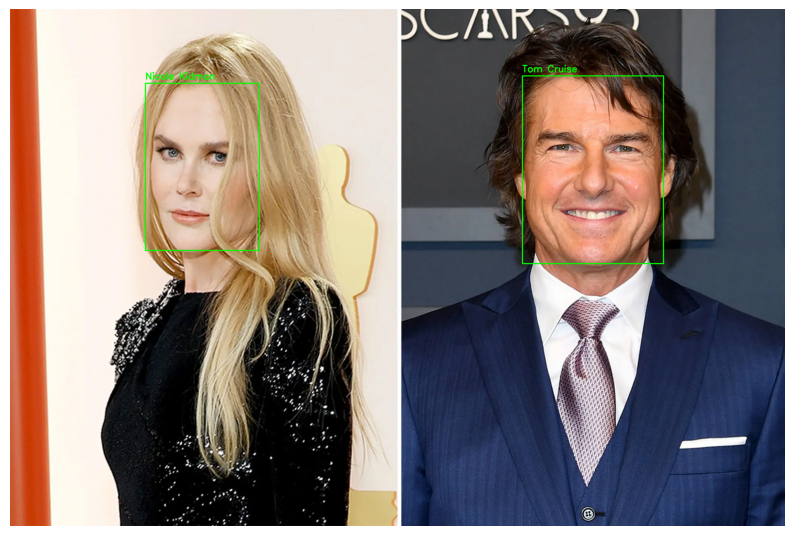

1/1 [==============================] - 0s 108ms/step


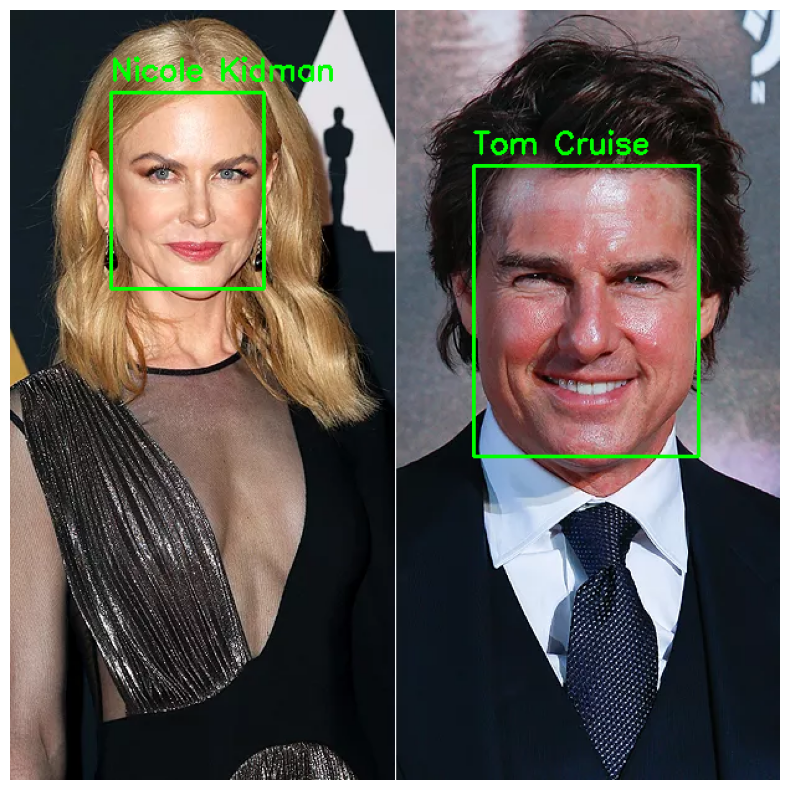

1/1 [==============================] - 0s 73ms/step


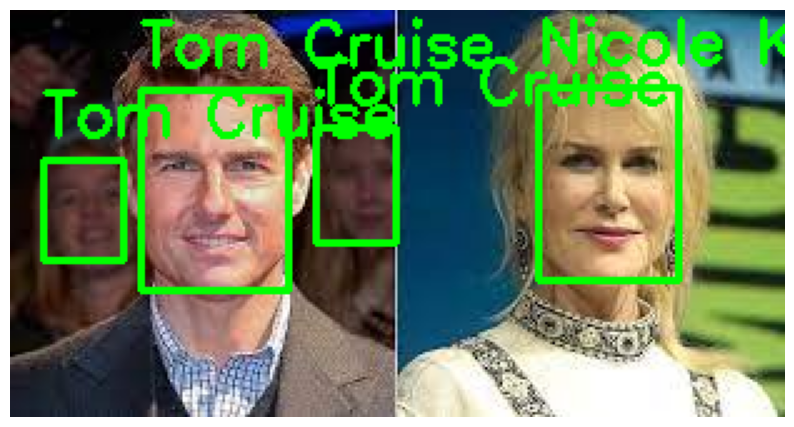

1/1 [==============================] - 0s 76ms/step


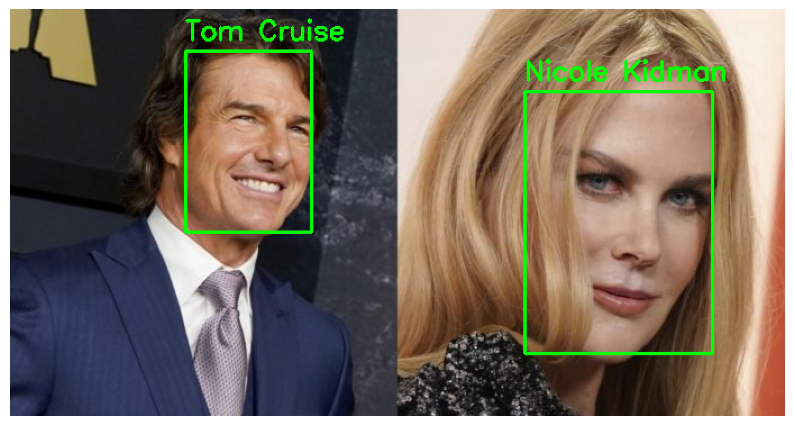

1/1 [==============================] - 0s 126ms/step


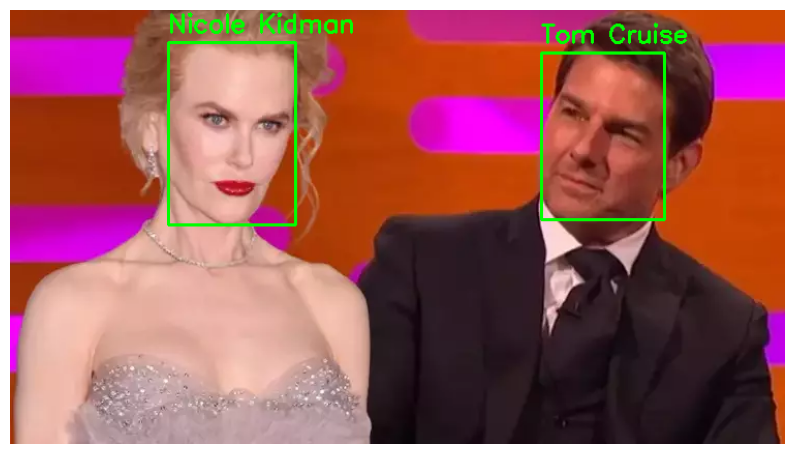

1/1 [==============================] - 0s 81ms/step


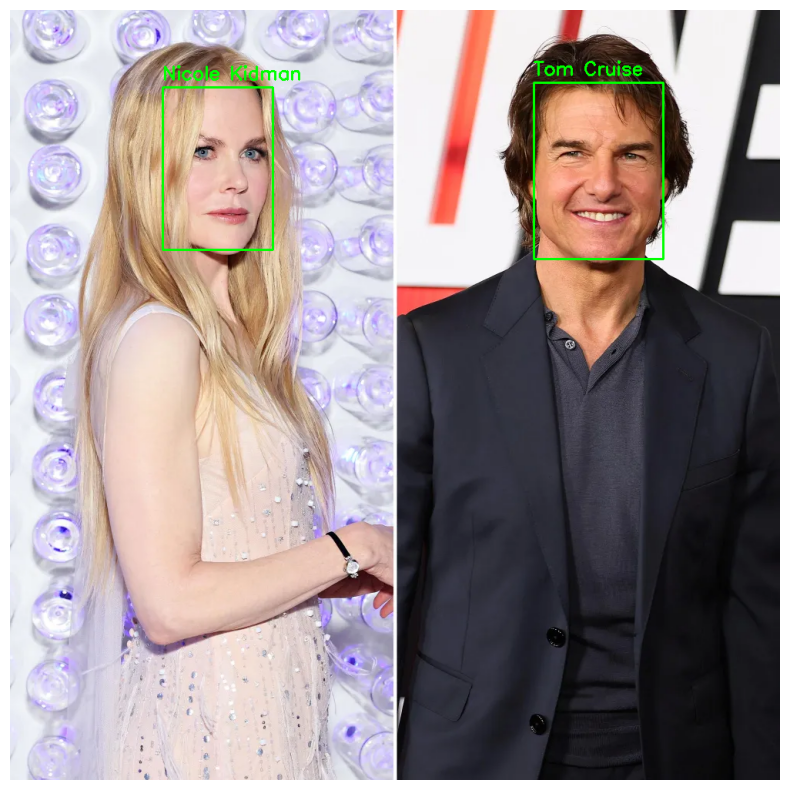

1/1 [==============================] - 0s 81ms/step


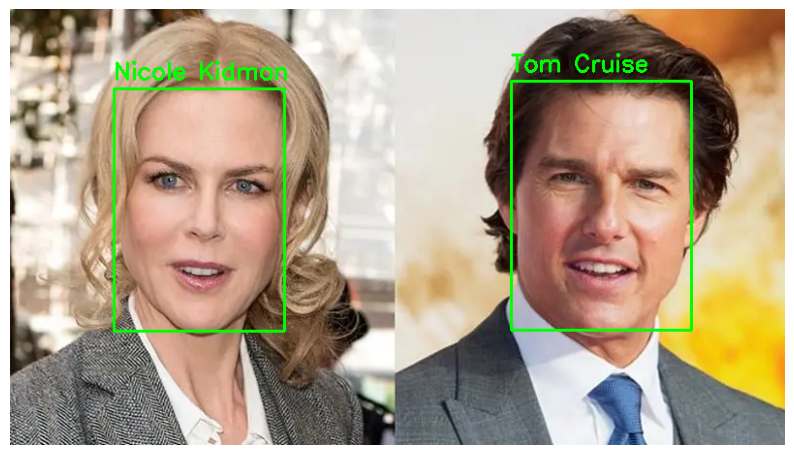

1/1 [==============================] - 0s 86ms/step


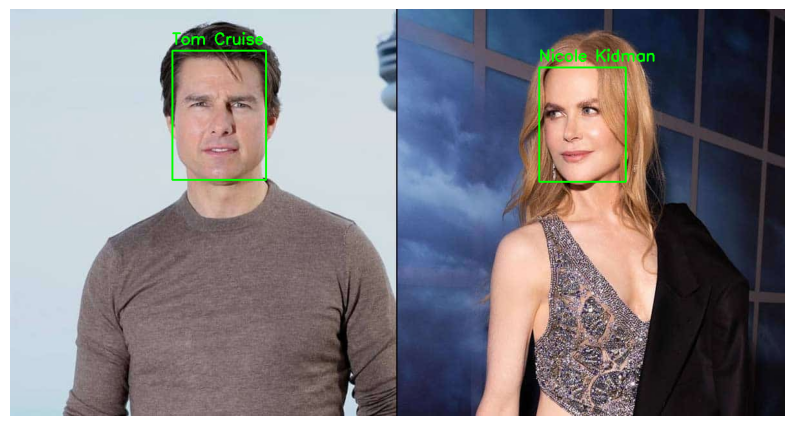

1/1 [==============================] - 0s 79ms/step


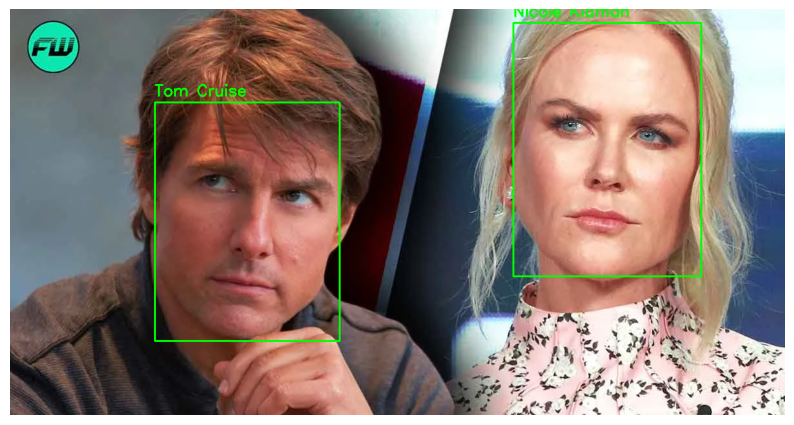

1/1 [==============================] - 0s 82ms/step


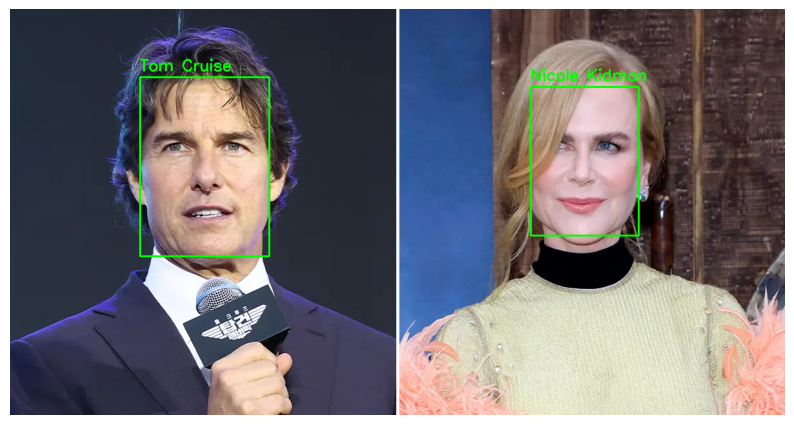

1/1 [==============================] - 0s 84ms/step


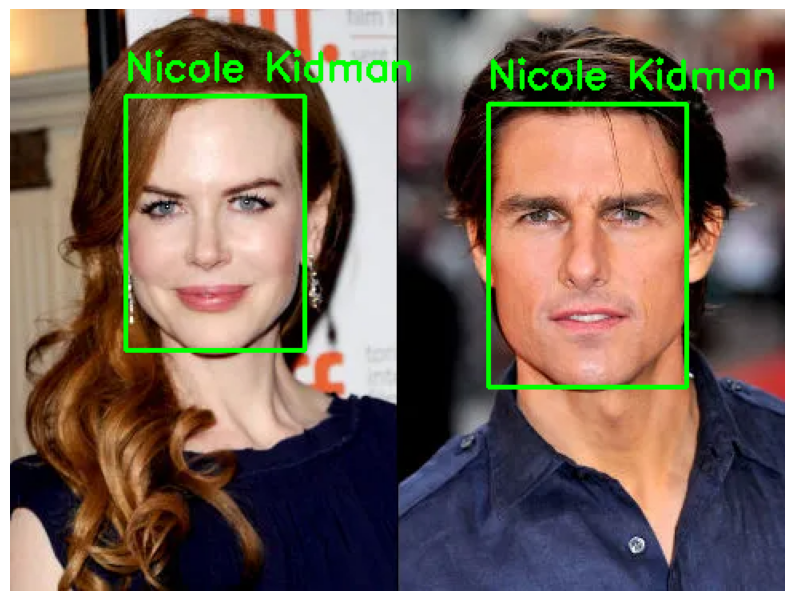

1/1 [==============================] - 0s 118ms/step


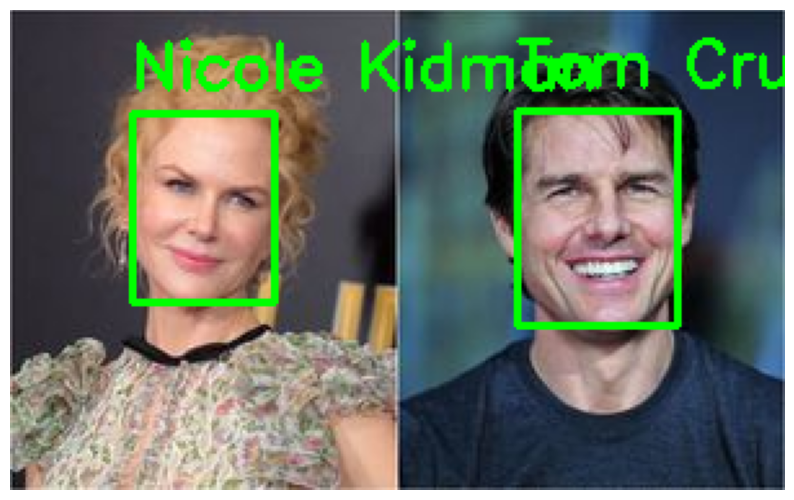

1/1 [==============================] - 0s 77ms/step


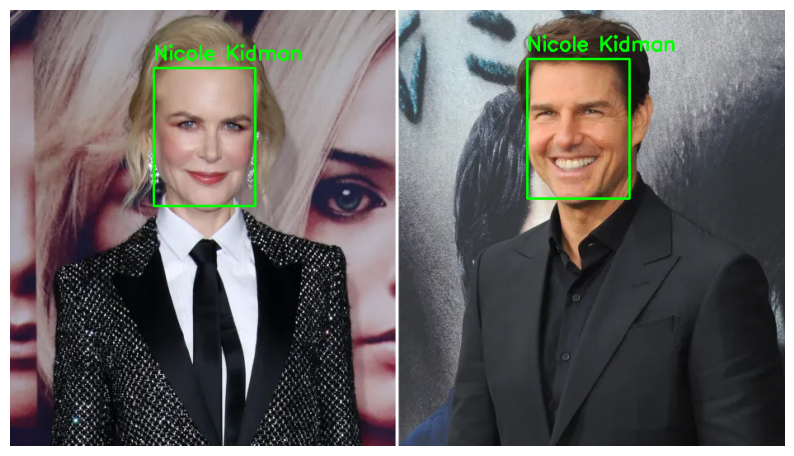

1/1 [==============================] - 0s 77ms/step


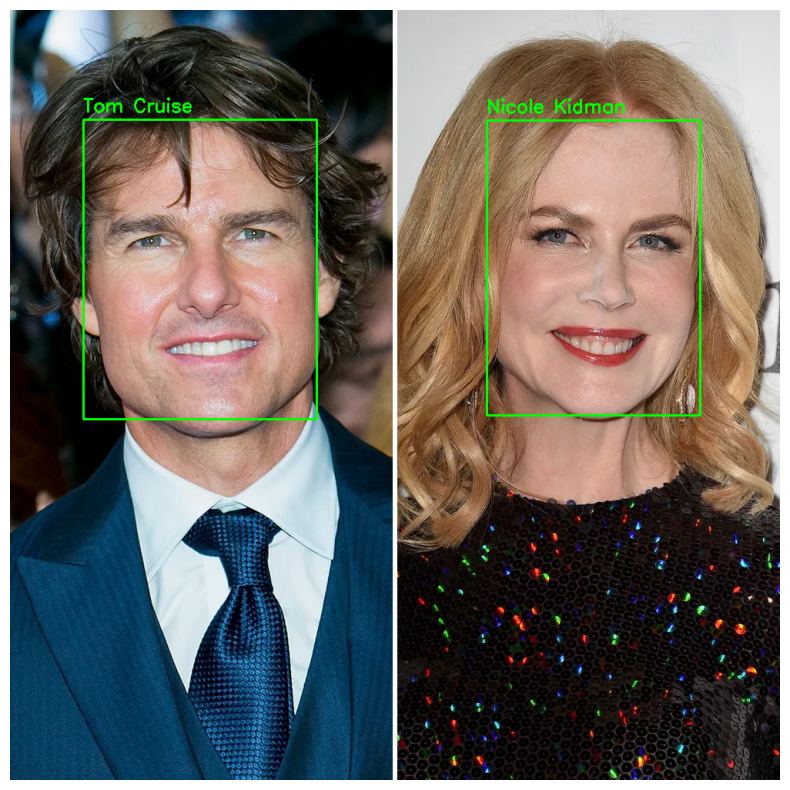

1/1 [==============================] - 0s 74ms/step


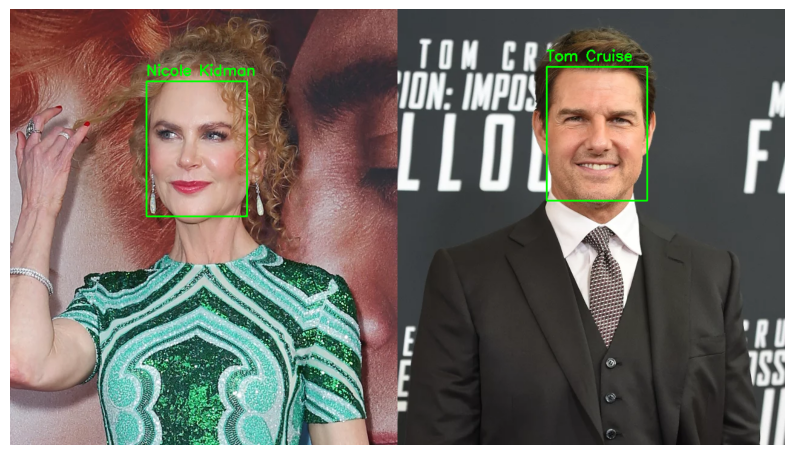

1/1 [==============================] - 0s 77ms/step


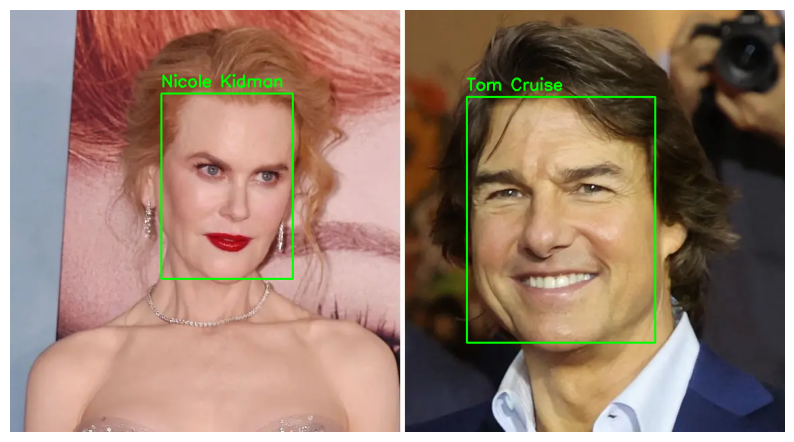

1/1 [==============================] - 0s 93ms/step


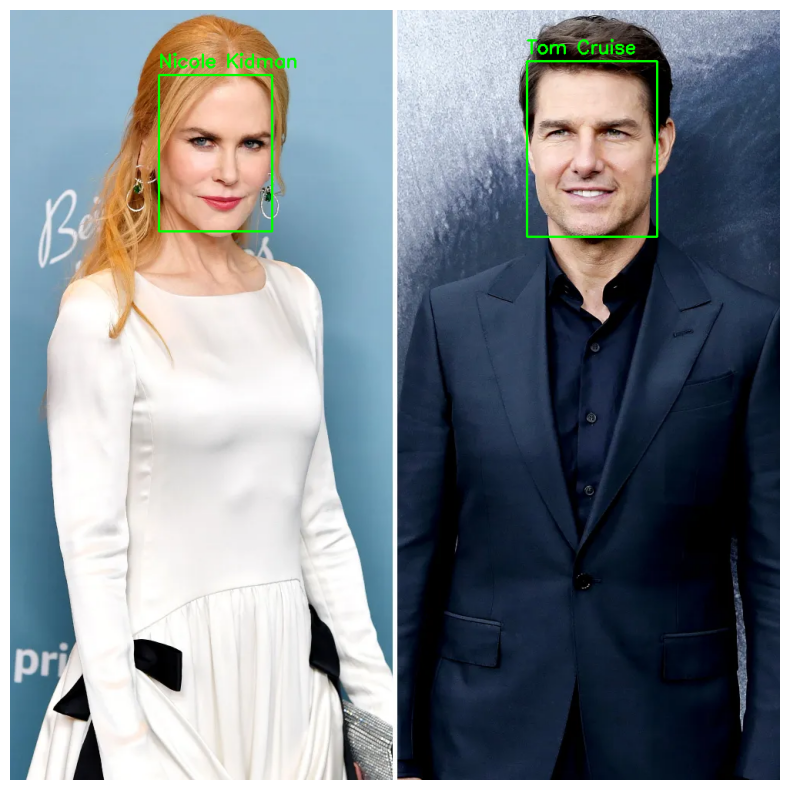

1/1 [==============================] - 0s 78ms/step


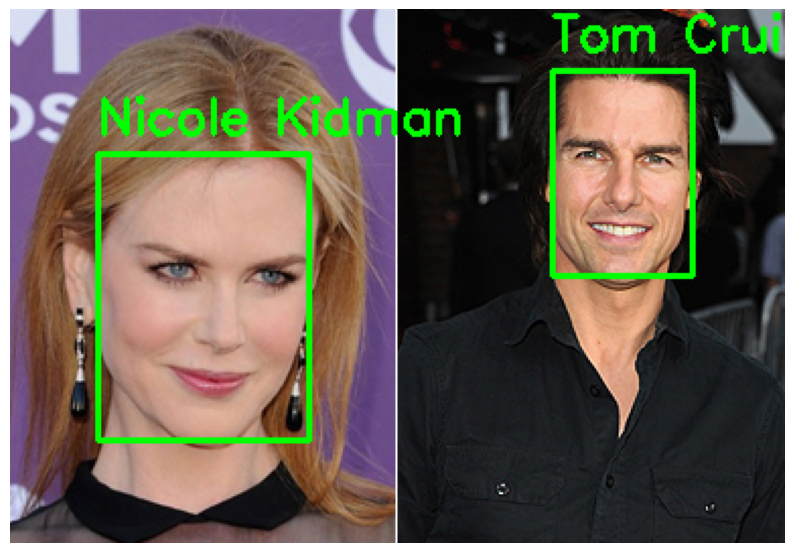

1/1 [==============================] - 0s 81ms/step


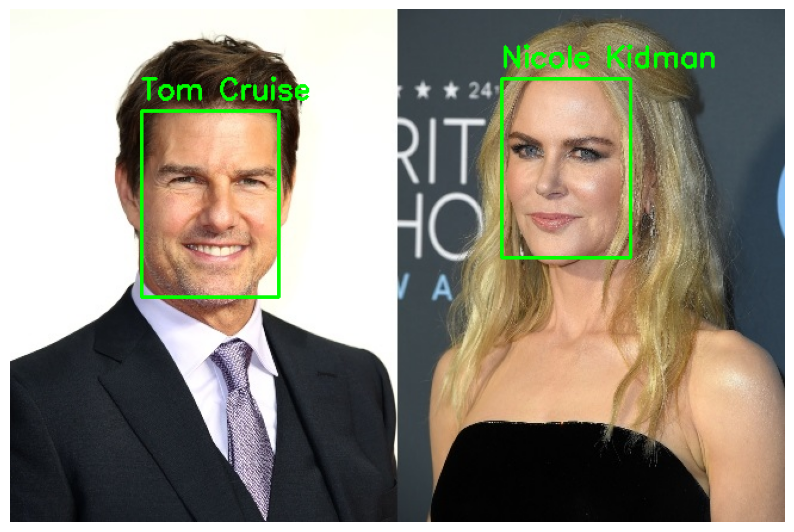

1/1 [==============================] - 0s 85ms/step


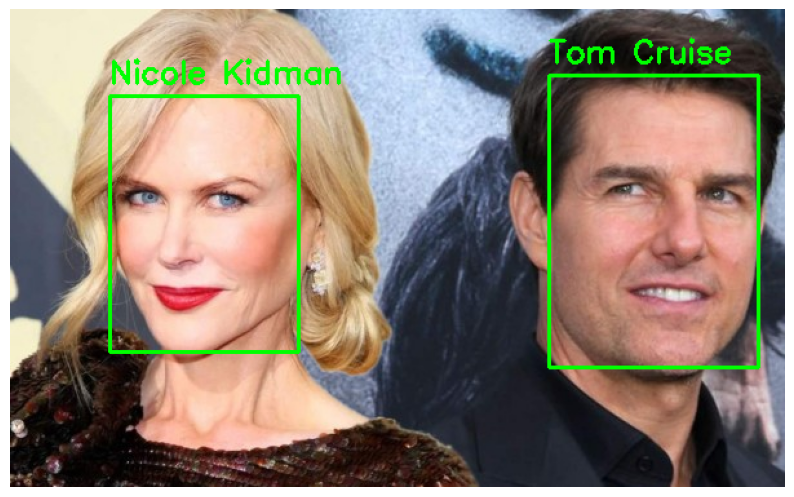

1/1 [==============================] - 0s 77ms/step


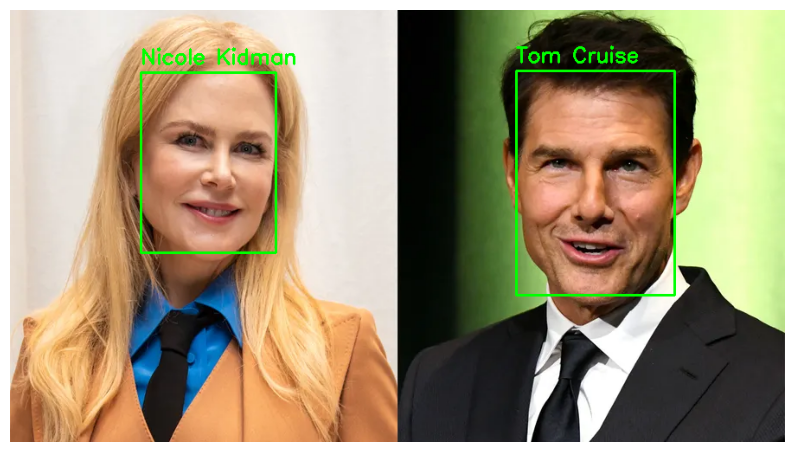

In [17]:
import os
import cv2
import numpy as np
import imghdr

def evaluate_accuracy(folder_path, model, class_indices):
    inverted_class_indices = {v: k for k, v in class_indices.items()}
    face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
    correct_predictions = 0
    total_images = 0

    for filename in os.listdir(folder_path):
        correct_predictions = 0
        total_images = 0
        image_path = os.path.join(folder_path, filename)

        # Check if the file is a directory
        if os.path.isdir(image_path):
            continue

        # Determine the image type using imghdr
        image_type = imghdr.what(image_path)

        # Check if the file is an image and the image type is supported
        if image_type in ['jpeg', 'png', 'webp', 'bmp']:
            identify_celebrities(model, image_path, class_indices)


test_folder_path = '/content/drive/MyDrive/toms/pics/togethor'
evaluate_accuracy(test_folder_path, model, class_indices)
